In [1]:
## Imports

import os
from pathlib import Path
from rosbags.highlevel import AnyReader
from rosbags.image import message_to_cvimage
from rosbags.typesys import Stores, get_typestore
import numpy as np
import cv2
import matplotlib.pyplot as plt
import glob
import random
import matplotlib.image as mpimg
from IPython.display import display, Markdown


In [2]:
def extract_pose_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name):
    
    pose_output_path = os.path.join(task_output_root, pose_file_name)
    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    with AnyReader([bagpath], default_typestore=typestore) as reader, open(pose_output_path, 'w') as pose_output_file:
        # Write header
        header = "timestamp position.x position.y orientation.z\n"
        pose_output_file.write(header)

        # Find the connection for the topic
        connections = [x for x in reader.connections if x.topic == "/amcl_pose"]

        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Use attribute access instead of dictionary access
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            pos = msg.pose.pose.position
            ori = msg.pose.pose.orientation
            line = f"{t} {pos.x:.5f} {pos.y:.5f} {ori.z:.5f}\n"
            pose_output_file.write(line)
    #print("Pose extraction completed.")

def extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root):
    from pathlib import Path
    from rosbags.highlevel import AnyReader
    from rosbags.typesys import Stores, get_typestore

    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    topic_suffixes = {
        '/realsense_torso_front_camera/color/image_raw_throttle': '_t',
        '/realsense_front_camera/color/image_raw_throttle': '_f',
        '/realsense_left_camera/color/image_raw_throttle': '_l',
        '/realsense_right_camera/color/image_raw_throttle': '_r'
    }

    with AnyReader([bagpath], default_typestore=typestore) as reader:
        connections = [x for x in reader.connections if x.topic in topic_suffixes]
        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Convert ROS image message to OpenCV image
            img = message_to_cvimage(msg, 'bgr8')
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            suffix = topic_suffixes[connection.topic]
            img_name = f"{t}{suffix}.jpg"
            img_output_path = os.path.join(task_output_root, img_name)
            cv2.imwrite(img_output_path, img)
    #print("Image extraction completed.")

In [3]:
### Functions to average poses to match camera frames **********************************

def avg_poses(dataset_root, pose_file_name, avg_pose_file_name):
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if pose_file_name in filenames:
            task_pose_file_path = os.path.join(dirpath, pose_file_name)
            task_avg_pose_file_path = os.path.join(dirpath, avg_pose_file_name)
            process_poses_file(task_pose_file_path, task_avg_pose_file_path)
            
def process_poses_file(task_pose_file_path, task_avg_pose_file_path):
    # Dictionary: timestamp -> list of [x, y, z]
    poses_dict = {}
    with open(task_pose_file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            values = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses_dict.setdefault(timestamp, []).append(values)
    # Calculate averages and write to output
    with open(task_avg_pose_file_path, 'w') as f:
        f.write("timestamp position.x position.y orientation.z\n")
        for timestamp in sorted(poses_dict.keys()):
            arr = np.array(poses_dict[timestamp])
            avg = arr.mean(axis=0)
            f.write(f"{timestamp} {avg[0]:.5f} {avg[1]:.5f} {avg[2]:.5f}\n")

In [4]:
### Functions to plot poses **************************************************************

def read_poses_avg(file_path):
    xs, ys, zs = [], [], []
    with open(file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            xs.append(float(tokens[1]))
            ys.append(float(tokens[2]))
            zs.append(float(tokens[3]))
    return np.array(xs), np.array(ys), np.array(zs)

def plot_orientations(xs, ys, zs, color, label, scale=0.5):
    plt.plot(xs, ys, marker='o', color=color, label=label)
    for x, y, z in zip(xs, ys, zs):
        dx = scale * np.cos(z)
        dy = scale * np.sin(z)
        plt.arrow(x, y, dx, dy, head_width=0.1, head_length=0.1, fc=color, ec=color, alpha=0.6)

def plot_poses(dataset_root, avg_pose_file_name, fig_width=48, fig_height=36, dpi=200):
    plt.figure(figsize=(fig_width, fig_height))
    color_cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    color_idx = 0

    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if "poses_avg.txt" in filenames:
            file_path = os.path.join(dirpath, "poses_avg.txt")
            xs, ys, zs = read_poses_avg(file_path)
            label = os.path.relpath(dirpath, dataset_root)
            color = color_cycle[color_idx % len(color_cycle)]
            plot_orientations(xs, ys, zs, color, label)
            color_idx += 1

    plt.xlabel("Position X")
    plt.ylabel("Position Y")
    plt.title("Overlayed Average Poses from All Folders")
    #plt.legend()
    plt.axis('equal')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()

In [5]:
### Functions to output image pose pairs *************************************************

def parse_poses_file(poses_path):
    poses = {}
    with open(poses_path, "r") as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            position = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses[timestamp] = position
    return poses

def timestamp_from_filename(filename):
    base = os.path.basename(filename)
    return base.split('_')[0]

def collect_images_and_poses(dataset_root, avg_pose_file_name, image_pose_path):
    rows = []
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if avg_pose_file_name in filenames:
            poses_path = os.path.join(dirpath, avg_pose_file_name)
            poses = parse_poses_file(poses_path)
            images = glob.glob(os.path.join(dirpath, "*.jpg"))
            for img in images:
                ts = timestamp_from_filename(img)
                if ts in poses:
                    rel_img_path = os.path.relpath(img, dataset_root)
                    x, y, theta = poses[ts]
                    rows.append(f"{rel_img_path} {x} {y} {theta}")
                    
    with open(image_pose_path, "w") as f:
        for row in rows:
            f.write(row + "\n")

In [6]:
### Functions to filter images based on their brightness *********************************

def compute_brightness(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None
    return img.mean()
    
def is_valid_image(image_path, min_brightness, max_brightness):
    if not os.path.exists(image_path):
        return False
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return False
    mean_brightness = img.mean()
    return min_brightness <= mean_brightness <= max_brightness
    
def filter_images(dataset_root, image_pose_path, filtered_image_pose_path, min_brightness, max_brightness, image_col_index=0, delimiter=' '):
    with open(image_pose_path, 'r') as infile, open(filtered_image_pose_path, 'w') as outfile:
        for line in infile:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue
            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if is_valid_image(full_path, min_brightness, max_brightness):
                outfile.write(line)

def plot_brightness(dataset_root, image_pose_path, image_col_index=0, delimiter=' '):
    brightness_values = []
    with open(image_pose_path, 'r') as file:
        for line in file:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue

            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if not os.path.exists(full_path):
                continue

            brightness = compute_brightness(full_path)
            if brightness is not None:
                brightness_values.append(brightness)

    # Plot brightness histogram
    plt.hist(brightness_values, bins=50, color='skyblue', edgecolor='black')
    plt.title("Image Brightness Distribution")
    plt.xlabel("Mean Brightness (0 = dark, 255 = bright)")
    plt.ylabel("Number of Images")
    plt.grid(True)
    plt.show()  
    return brightness_values

In [7]:
### Functions to create the ground truth *************************************************

def read_pose_file(pose_file_path):
    all_images = []
    with open(pose_file_path, "r") as f:
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            img_path = tokens[0]
            x, y = float(tokens[1]), float(tokens[2])
            ts = tokens[3]
            all_images.append({
                "path": img_path,
                "position": np.array([x, y]),
                "timestamp": ts
            })
    return all_images

def get_suffix(filename):
    """Extracts the suffix (e.g., '_t', '_r', '_f', '_l') from the filename before the extension."""
    base = os.path.splitext(os.path.basename(filename))[0]
    # Assumes the suffix is the last two characters (e.g., '_t')
    return base[-2:]
    
def get_folder(path):
    # Returns the immediate parent directory name
    return os.path.normpath(path).split(os.sep)[0]

def mine_triplets_other_folders_with_suffix(all_images, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD):
    # Precompute arrays for fast indexing
    positions = np.array([img["position"] for img in all_images])
    paths = np.array([img["path"] for img in all_images])
    suffixes = np.array([get_suffix(p) for p in paths])
    folders = np.array([get_folder(p) for p in paths])

    triplets = []

    # For each unique (suffix), group indices to reduce comparisons
    for suffix in np.unique(suffixes):
        idx_with_suffix = np.where(suffixes == suffix)[0]
        # For each unique folder in this suffix group
        for anchor_folder in np.unique(folders[idx_with_suffix]):
            anchor_idx = idx_with_suffix[folders[idx_with_suffix] == anchor_folder]
            # Candidates: same suffix, different folder
            candidate_idx = idx_with_suffix[folders[idx_with_suffix] != anchor_folder]
            if len(candidate_idx) == 0 or len(anchor_idx) == 0:
                continue
            # Precompute candidate positions
            candidate_positions = positions[candidate_idx]
            candidate_paths = paths[candidate_idx]
            candidate_folders = folders[candidate_idx]
            # For each anchor in this group
            for i in anchor_idx:
                anchor_pos = positions[i]
                anchor_path = paths[i]
                # Compute distances to all candidates in one go
                dists = np.linalg.norm(candidate_positions - anchor_pos, axis=1)
                # Mask for positives and negatives
                pos_mask = (dists > 0) & (dists <= POSITIVE_DISTANCE_THRESHOLD)
                neg_mask = (dists >= NEGATIVE_DISTANCE_THRESHOLD)
                pos_candidates = candidate_paths[pos_mask]
                neg_candidates = candidate_paths[neg_mask]
                if len(pos_candidates) > 0 and len(neg_candidates) > 0:
                    pos_path = np.random.choice(pos_candidates)
                    neg_path = np.random.choice(neg_candidates)
                    triplets.append((anchor_path, pos_path, neg_path))
    return triplets

def mine_triplets_other_folders_with_suffix_old(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    suffixes = [get_suffix(p) for p in paths]
    folders = [get_folder(p) for p in paths]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        anchor_suffix = get_suffix(anchor_path)
        anchor_folder = get_folder(anchor_path)
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        # Only select candidates from different folders and with the same suffix
        positive_candidates = [
            p for i, (d, p, s, f) in enumerate(zip(dists, paths, suffixes, folders))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix and f != anchor_folder
        ]
        negative_candidates = [
            p for i, (d, p, s, f) in enumerate(zip(dists, paths, suffixes, folders))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix and f != anchor_folder
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets
    
def mine_triplets_with_suffix(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    suffixes = [get_suffix(p) for p in paths]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        anchor_suffix = get_suffix(anchor_path)
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        # Filter candidates to only those with the same suffix as anchor
        positive_candidates = [
            p for i, (d, p, s) in enumerate(zip(dists, paths, suffixes))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix
        ]
        negative_candidates = [
            p for i, (d, p, s) in enumerate(zip(dists, paths, suffixes))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets
    
def mine_triplets(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        positive_candidates = [
            p for i, (d, p) in enumerate(zip(dists, paths))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path
        ]
        negative_candidates = [
            p for i, (d, p) in enumerate(zip(dists, paths))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets

In [8]:
### Adjust the params ********************************************************************

bags_root = '/home/jovyan/data/VPR/my_bags/All'
dataset_root = '/home/jovyan/data/VPR/my_dataset'

pose_file_name = "poses.txt"
avg_pose_file_name = "poses_avg.txt"

image_pose_path = os.path.join(dataset_root, "image_pose.txt")
filtered_image_pose_path = os.path.join(dataset_root, "filtered_image_pose.txt")
gt_path = os.path.join(dataset_root, "gt.txt")

POSITIVE_DISTANCE_THRESHOLD = 0.5
NEGATIVE_DISTANCE_THRESHOLD = 10.0

In [9]:
### Set the params first *****************************************************************

### Bag extraction ***********************************************************************
for bag_name in os.listdir(bags_root):
    if bag_name.endswith('.bag'):
        bag_name_noext, ext = os.path.splitext(bag_name)
        short_bag_name = bag_name_noext[:41]
        bag_path = os.path.join(bags_root, bag_name)
        # print(f"Processing {bag_path}")
        task_output_root = os.path.join(dataset_root, short_bag_name)
        os.makedirs(task_output_root, exist_ok=True)
        extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root)
        extract_pose_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name)
    
print("Finished bag file extraction")

Finished bag file extraction


In [10]:
### Pose average *************************************************************************
avg_poses(dataset_root, pose_file_name, avg_pose_file_name)
print("Finished pose averaging")

Finished pose averaging


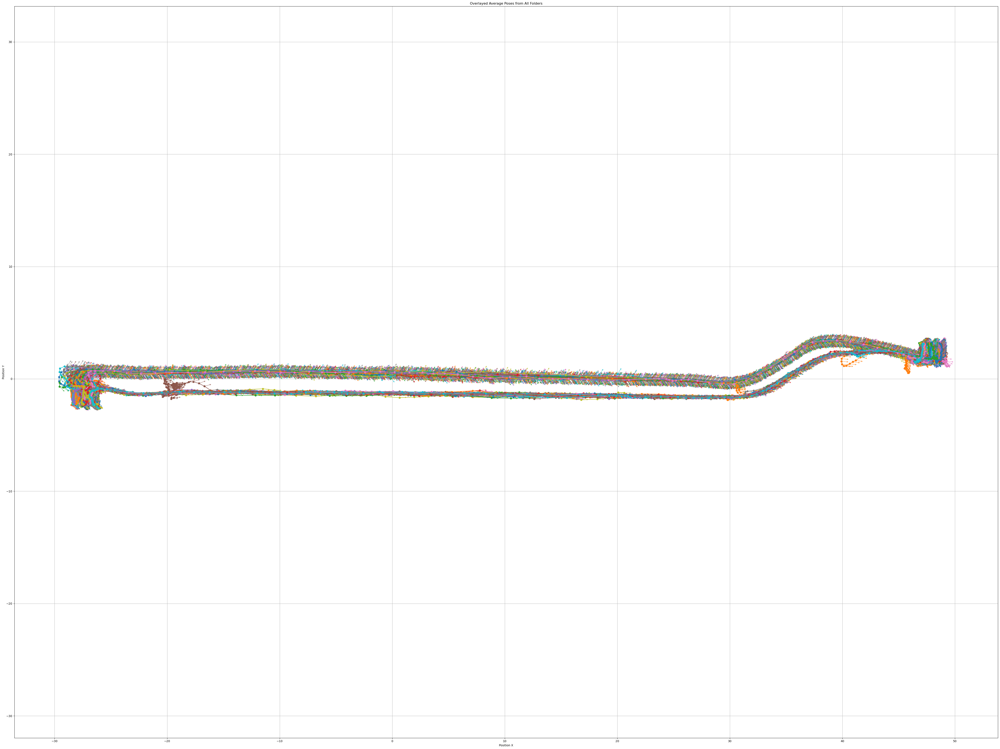

Finished pose plotting


In [11]:
### Plot poses ***************************************************************************
plot_poses(dataset_root, avg_pose_file_name)
print("Finished pose plotting")

In [12]:
### Output image_pose file ***************************************************************
collect_images_and_poses(dataset_root, avg_pose_file_name, image_pose_path)
print("Finished image pose pairing")

Finished image pose pairing


Before filtering


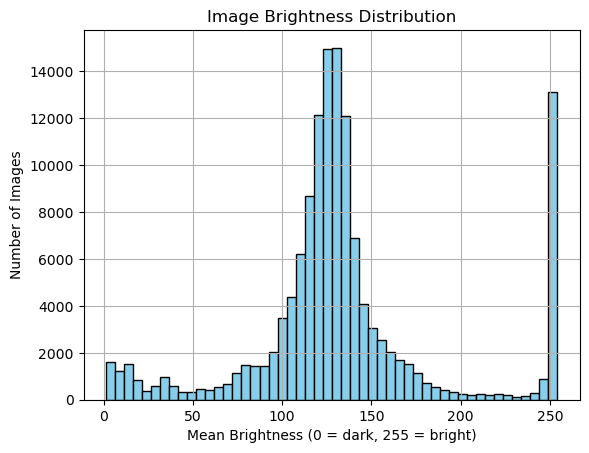

After filtering


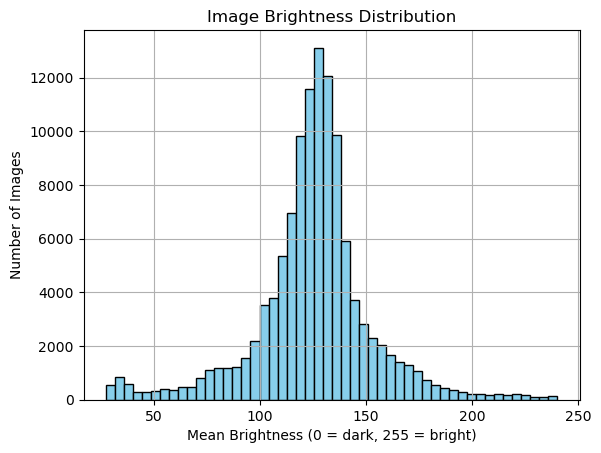

Finished image filtering


In [13]:
### Image filter *************************************************************************
print("Before filtering")
brightness_values = plot_brightness(dataset_root, image_pose_path)

brightness_mean = np.mean(brightness_values) 
brightness_std = np.std(brightness_values)

# First option using mean and std
min_brightness = brightness_mean-2*brightness_std
max_brightness = brightness_mean+2*brightness_std

# Second option using percentile is more robust to outliers 
# This keeps 96% of the images and trims 2% from each tail 
#min_brightness = np.percentile(brightness_values, 2)
#max_brightness = np.percentile(brightness_values, 98)

filter_images(dataset_root, image_pose_path, filtered_image_pose_path, min_brightness, max_brightness)

print("After filtering")
plot_brightness(dataset_root, filtered_image_pose_path)

print("Finished image filtering")

In [14]:
### Ground truth generation **************************************************************
all_images = read_pose_file(filtered_image_pose_path)

# Multiple options are available to control the ground truth generation

# First option is to do task selection and camera selection by random
#triplets = mine_triplets(all_images)

# Second option is to use same camera to find positive and negative cases
#triplets = mine_triplets_with_suffix(all_images)

# Third option is to use same camera but different task for case selection
triplets = mine_triplets_other_folders_with_suffix(all_images, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD)

with open(gt_path, "w") as f:
    for anchor, positive, negative in triplets:
        f.write(f"{anchor} {positive} {negative}\n")
print("Finished ground truth generation")

Finished ground truth generation


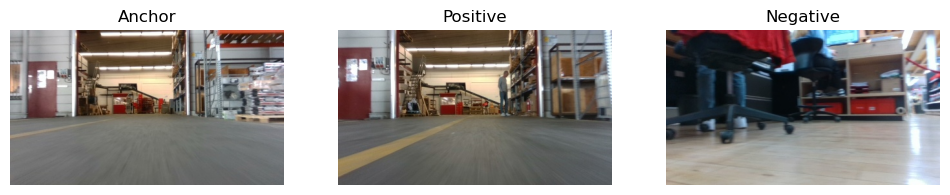

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730069_f.jpg`  
**Positive:** `task_7498a815-38db-44f2-99f4-85958d03d3d4/1748417189_f.jpg`  
**Negative:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895926_f.jpg`

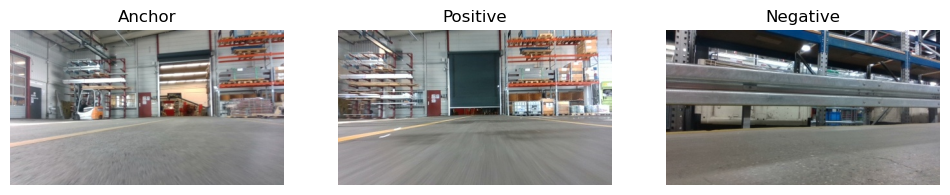

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730063_f.jpg`  
**Positive:** `task_0a94a4e2-5d5a-444e-b150-642302bc8805/1748265316_f.jpg`  
**Negative:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330787_f.jpg`

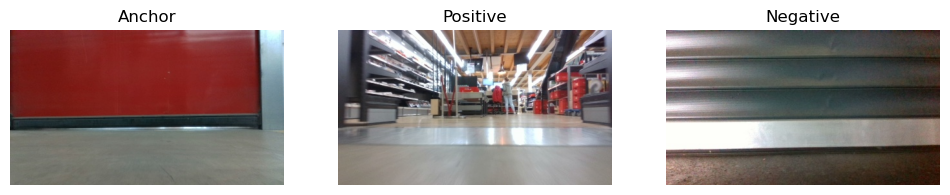

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730095_f.jpg`  
**Positive:** `task_229a697a-1c59-4a76-b4ea-2682adaa3cb4/1748248106_f.jpg`  
**Negative:** `task_72607ac4-b749-45da-8b53-ac5d59583058/1747976116_f.jpg`

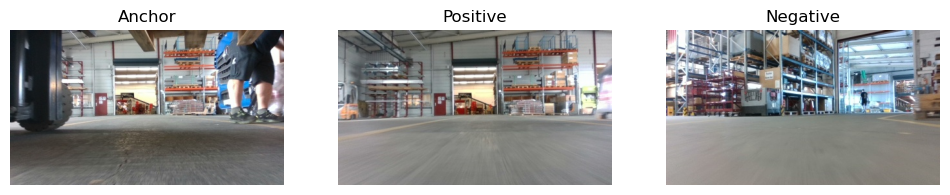

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730049_f.jpg`  
**Positive:** `task_e4cef4d1-0e3a-4fdc-b13a-b48cf1809bc1/1747721996_f.jpg`  
**Negative:** `task_d3116efb-6ddf-4f68-b516-a87eaa5b0ce1/1747649434_f.jpg`

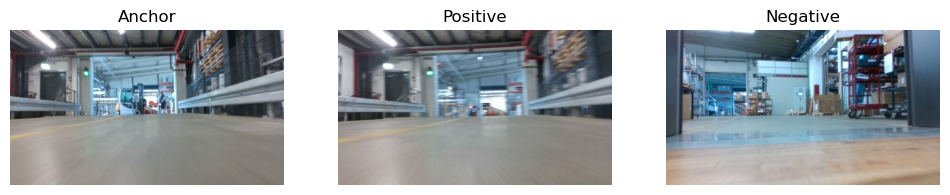

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730032_f.jpg`  
**Positive:** `task_34455338-79e9-4b4e-af42-df0de388f76d/1747815546_f.jpg`  
**Negative:** `task_a95c5627-2c1d-47e7-b298-b231237b47fd/1748434661_f.jpg`

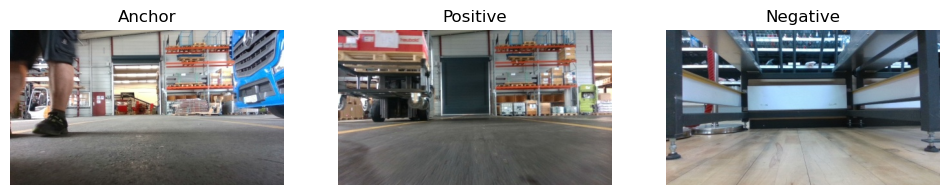

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730054_f.jpg`  
**Positive:** `task_3037d52e-157f-45ab-98f8-b681ae1d7ad0/1748439829_f.jpg`  
**Negative:** `task_9d12c7b5-474e-4298-be63-87b072e079e9/1748236265_f.jpg`

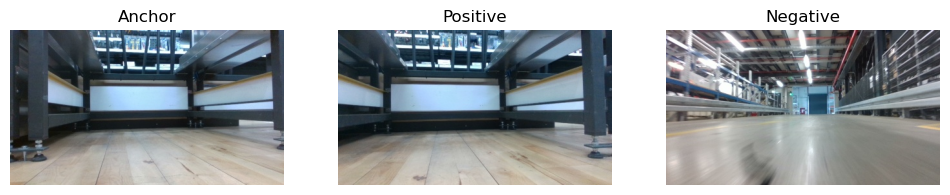

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730121_f.jpg`  
**Positive:** `task_4b4f17a3-aa00-4495-b4ea-b754bd074810/1747318482_f.jpg`  
**Negative:** `task_14991870-9a9e-4734-a101-6ff8be6b3fca/1748422742_f.jpg`

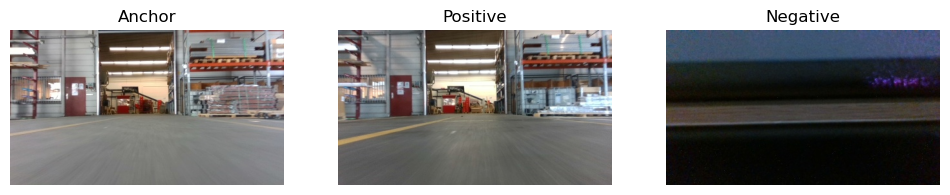

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730067_f.jpg`  
**Positive:** `task_6af25542-0566-4998-8b90-285f7b5299ed/1747816164_f.jpg`  
**Negative:** `task_aa3645c6-b26b-4aa5-a972-141525bfaf25/1747838982_f.jpg`

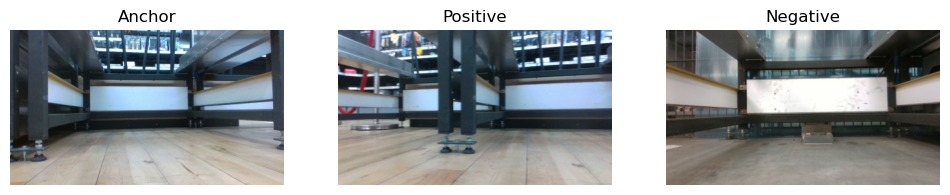

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730123_f.jpg`  
**Positive:** `task_70e2f625-aaa9-4bc8-ba95-932cc3018957/1747403378_f.jpg`  
**Negative:** `task_48c25151-12e8-49aa-906d-417d53fdb4ce/1747656127_f.jpg`

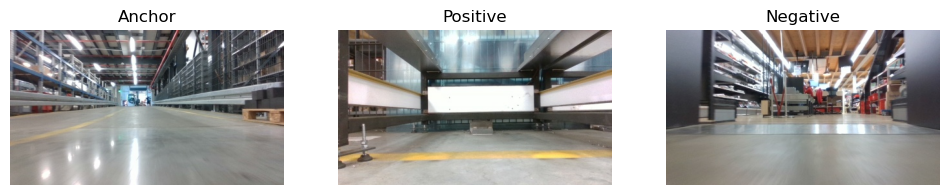

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730020_f.jpg`  
**Positive:** `task_229a697a-1c59-4a76-b4ea-2682adaa3cb4/1748248043_f.jpg`  
**Negative:** `task_070773af-3e59-4f14-96fb-85284ce3fe6c/1747983671_f.jpg`

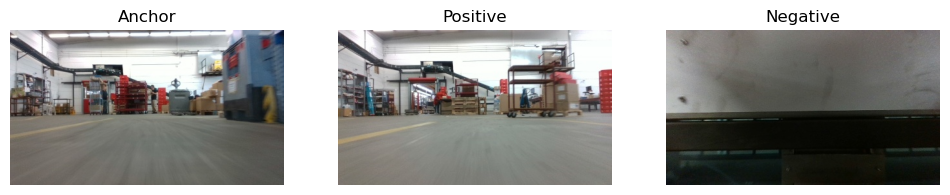

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730076_f.jpg`  
**Positive:** `task_e461bff2-b70e-4da1-bd23-f2726136f435/1748420921_f.jpg`  
**Negative:** `task_40840fba-2897-41b2-9ef4-7e60d418843a/1748339897_f.jpg`

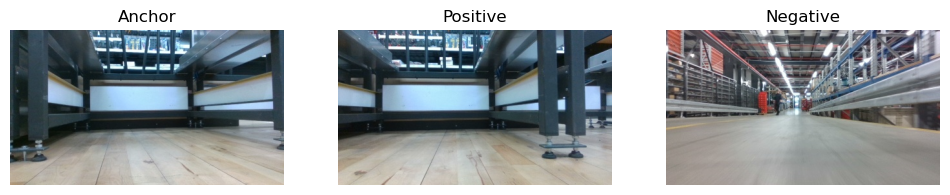

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730122_f.jpg`  
**Positive:** `task_155e82ec-79bd-49b1-9253-e44eb119ba14/1748354907_f.jpg`  
**Negative:** `task_b60ddbdb-adbc-432a-abcc-b1311a542b20/1747920425_f.jpg`

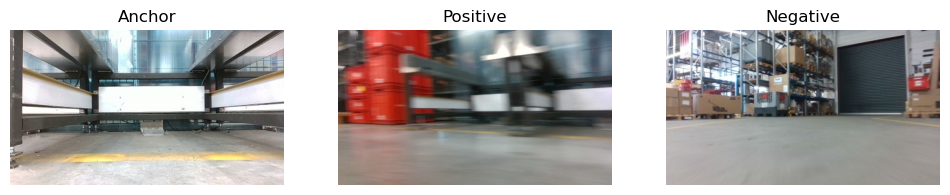

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730006_f.jpg`  
**Positive:** `task_b34c9e77-c7e9-4c2c-8786-e2aaf0a863ff/1747655546_f.jpg`  
**Negative:** `task_fb1af91e-81ed-4f83-b4e2-d3ec2c607458/1748241091_f.jpg`

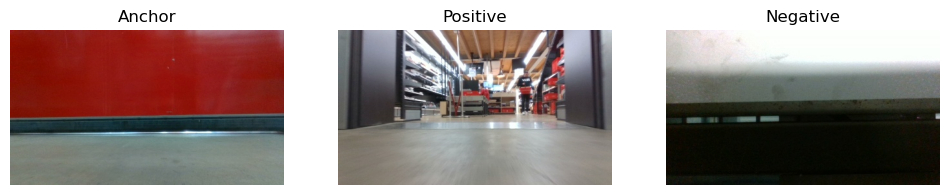

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730097_f.jpg`  
**Positive:** `task_62f522fe-67c6-40fe-83af-290f64da7db0/1748243543_f.jpg`  
**Negative:** `task_be3ac756-8f70-4406-8542-201c8fad9f93/1747657724_f.jpg`

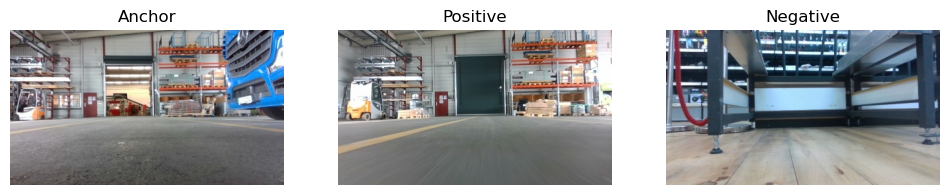

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730058_f.jpg`  
**Positive:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000227_f.jpg`  
**Negative:** `task_3769d6fb-c138-488b-b636-d118395ebab7/1748262776_f.jpg`

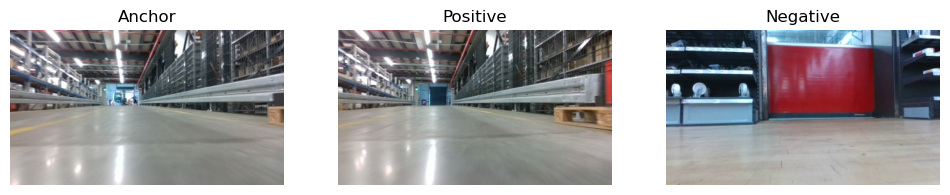

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730021_f.jpg`  
**Positive:** `task_52612c7c-7aa5-4096-a0de-0dd603c4c93e/1748268915_f.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922737_f.jpg`

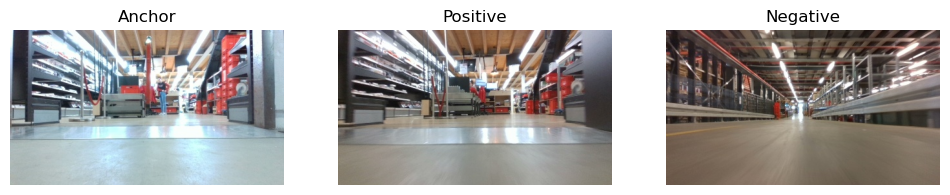

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730099_f.jpg`  
**Positive:** `task_9a3f4071-8933-4229-a053-dee7a402e2e6/1748249673_f.jpg`  
**Negative:** `task_707a111d-5448-4c75-baf4-6b72dfdbe473/1747988174_f.jpg`

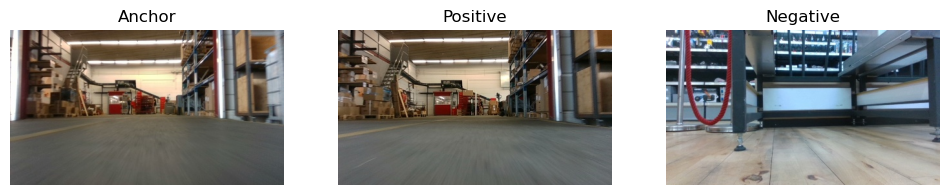

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730071_f.jpg`  
**Positive:** `task_c40dff0b-1c65-4f58-ba3c-595efca479da/1747655952_f.jpg`  
**Negative:** `task_8aa2af4a-bae3-432f-96fd-c3654229b402/1748332956_f.jpg`

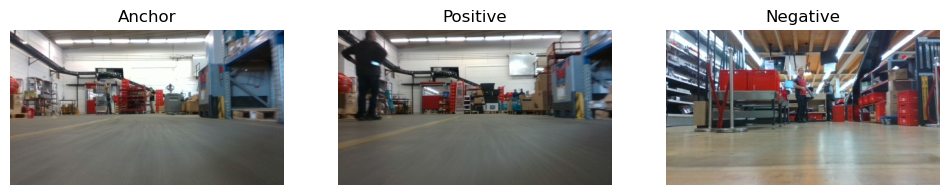

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730075_f.jpg`  
**Positive:** `task_27edfed1-08f7-47fa-9006-70e5acc8556d/1747986571_f.jpg`  
**Negative:** `task_96c959ea-db3c-4c49-a09f-84d4c35b4911/1747991708_f.jpg`

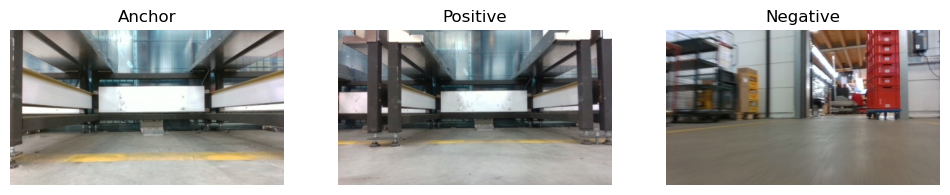

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730009_f.jpg`  
**Positive:** `task_cbcf7893-3ef4-411c-9159-79b63669d502/1748422046_f.jpg`  
**Negative:** `task_74a69959-8c6f-45cc-ba61-562fc7653487/1747646710_f.jpg`

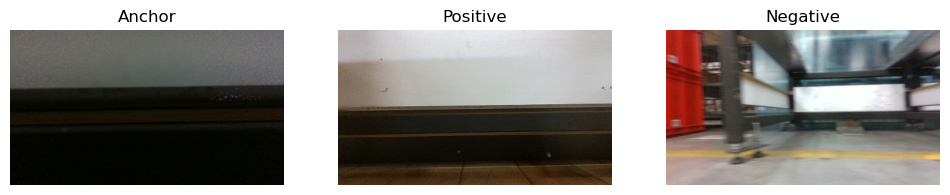

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730137_f.jpg`  
**Positive:** `task_b0286178-1c0e-4db8-af56-1a1fe5a5e8d0/1748260320_f.jpg`  
**Negative:** `task_5494a279-8247-448c-b8c2-5f8ac595fd07/1748011467_f.jpg`

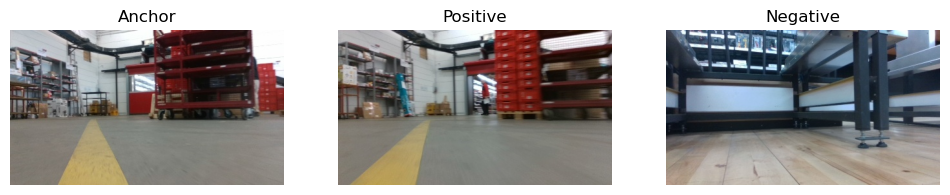

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730083_f.jpg`  
**Positive:** `task_95837967-d232-4bdf-b8ea-3849961af5c4/1748238289_f.jpg`  
**Negative:** `task_d64ed855-eec6-48f6-9052-7740864ab548/1747718472_f.jpg`

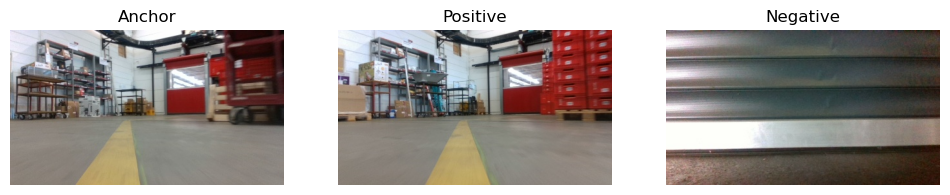

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730085_f.jpg`  
**Positive:** `task_9c58ecc8-4c4b-4b8d-ab8a-239240e87b26/1748004265_f.jpg`  
**Negative:** `task_72607ac4-b749-45da-8b53-ac5d59583058/1747976155_f.jpg`

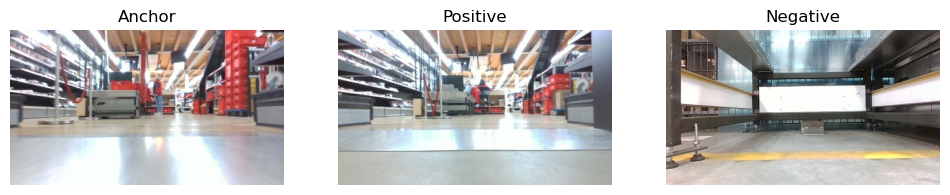

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730102_f.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921900_f.jpg`  
**Negative:** `task_bbed0b01-d707-419f-8e11-65e7be234f07/1748239061_f.jpg`

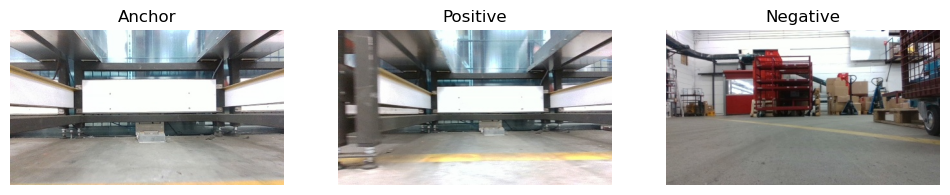

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730002_f.jpg`  
**Positive:** `task_d43b6e7e-da81-4542-a14e-34e3f27503c1/1747724777_f.jpg`  
**Negative:** `task_d64ed855-eec6-48f6-9052-7740864ab548/1747718410_f.jpg`

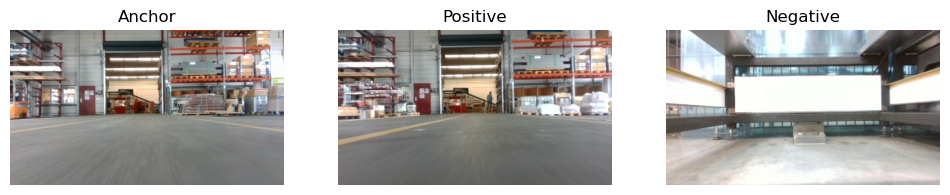

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730065_f.jpg`  
**Positive:** `task_7498a815-38db-44f2-99f4-85958d03d3d4/1748417185_f.jpg`  
**Negative:** `task_3ff5fb5d-a693-402b-8e1d-ac5108bd5804/1747993592_f.jpg`

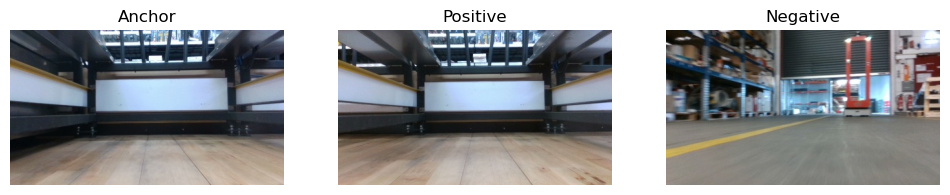

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730130_f.jpg`  
**Positive:** `task_e2d790f0-470d-416b-8f4a-8f6a1a5bb409/1748251382_f.jpg`  
**Negative:** `task_23369028-228e-4d87-be9a-02b9b31eddf8/1748426960_f.jpg`

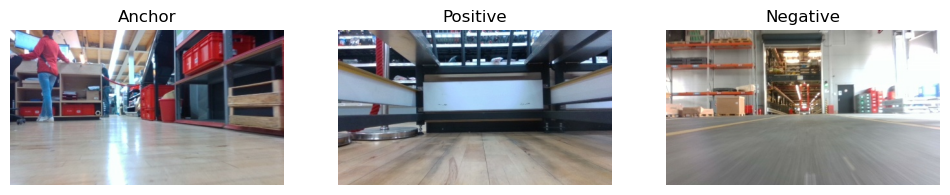

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730109_f.jpg`  
**Positive:** `task_c93dee1b-f29b-4e9b-8b68-37c69e54bd2f/1748250305_f.jpg`  
**Negative:** `task_aa7e245a-9282-4b45-be8c-a8bac7fa1c84/1748340108_f.jpg`

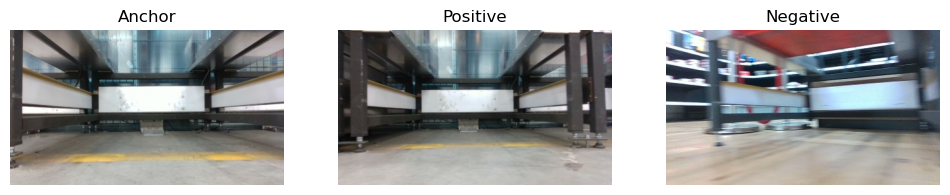

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730012_f.jpg`  
**Positive:** `task_364408b2-6bf2-4704-af54-25b9037258af/1747725082_f.jpg`  
**Negative:** `task_707a111d-5448-4c75-baf4-6b72dfdbe473/1747988125_f.jpg`

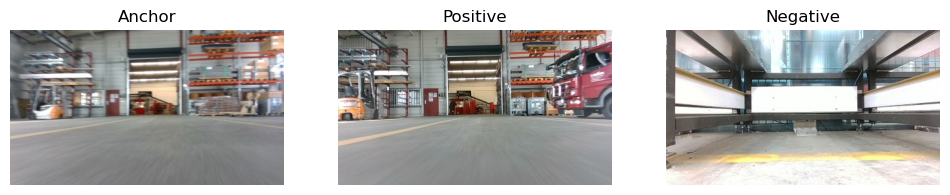

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730064_f.jpg`  
**Positive:** `task_4b4f17a3-aa00-4495-b4ea-b754bd074810/1747318362_f.jpg`  
**Negative:** `task_3d5e0085-2129-45b1-a3ff-33fde3c58a59/1747638660_f.jpg`

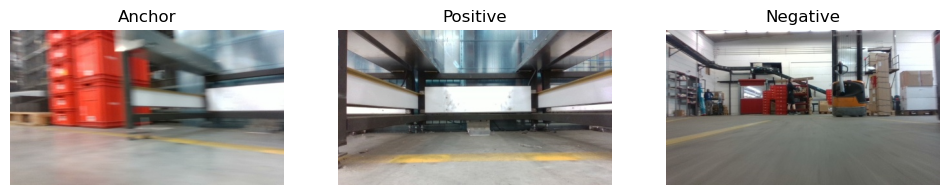

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730016_f.jpg`  
**Positive:** `task_97f7caa8-e8d1-45b7-b9ad-ab214ace84e3/1747814514_f.jpg`  
**Negative:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330935_f.jpg`

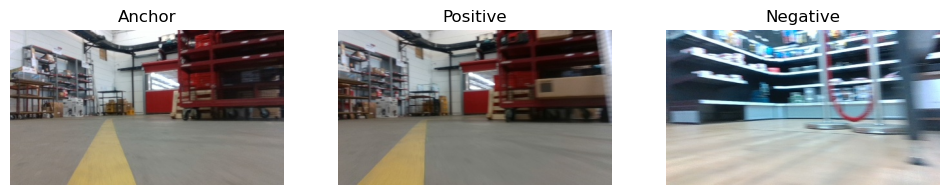

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730084_f.jpg`  
**Positive:** `task_140888d9-739b-4f18-9f7a-2e1d96e71446/1747653437_f.jpg`  
**Negative:** `task_b259588a-6253-410f-a1a6-ed72bf8e2804/1747643745_f.jpg`

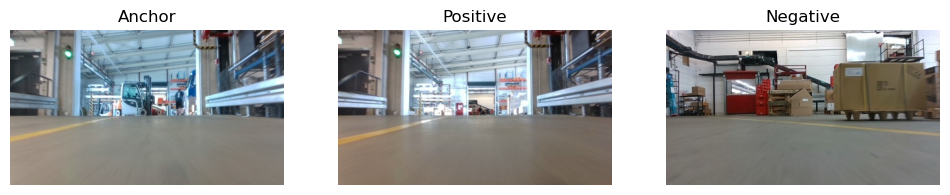

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730034_f.jpg`  
**Positive:** `task_eb395555-4ae0-4747-bdcb-2a91017fe477/1747986960_f.jpg`  
**Negative:** `task_f436ef6e-13c1-4eaa-a6d3-60fa145b4bb0/1748348699_f.jpg`

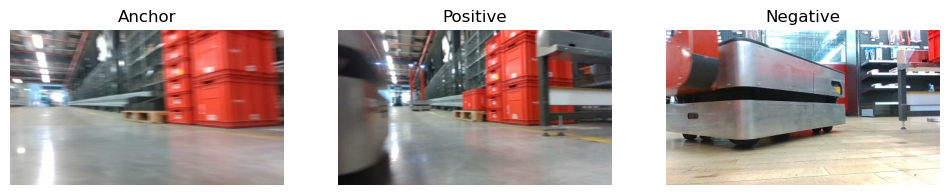

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730017_f.jpg`  
**Positive:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330621_f.jpg`  
**Negative:** `task_aa7e245a-9282-4b45-be8c-a8bac7fa1c84/1748340063_f.jpg`

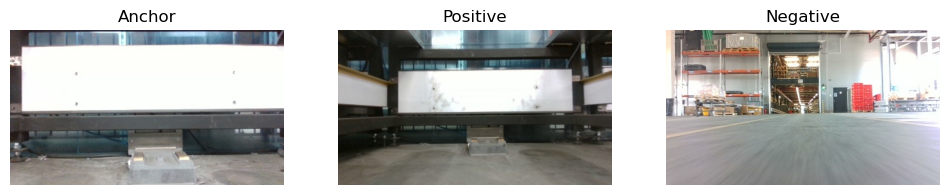

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729997_f.jpg`  
**Positive:** `task_a7571975-77c8-4756-967e-979b2344ecc6/1748419196_f.jpg`  
**Negative:** `task_d328cea0-2527-48ec-93e8-bd8728036510/1747651442_f.jpg`

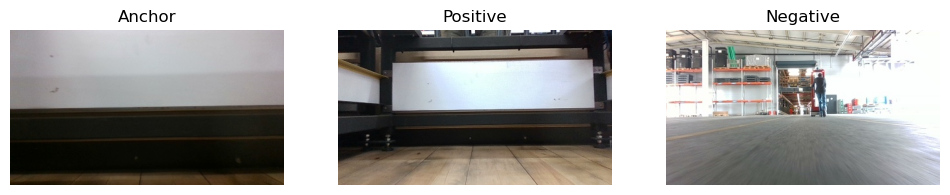

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730135_f.jpg`  
**Positive:** `task_d64ed855-eec6-48f6-9052-7740864ab548/1747718492_f.jpg`  
**Negative:** `task_0a66905f-f5c1-4705-820c-daaacd0e511e/1748006111_f.jpg`

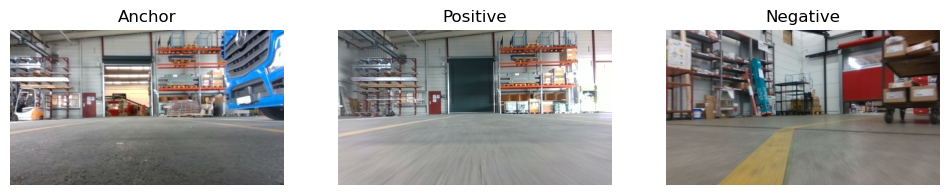

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730057_f.jpg`  
**Positive:** `task_5494a279-8247-448c-b8c2-5f8ac595fd07/1748011496_f.jpg`  
**Negative:** `task_e25e1409-7fc5-4a3f-9b5b-3ea9ec09b0d7/1747922655_f.jpg`

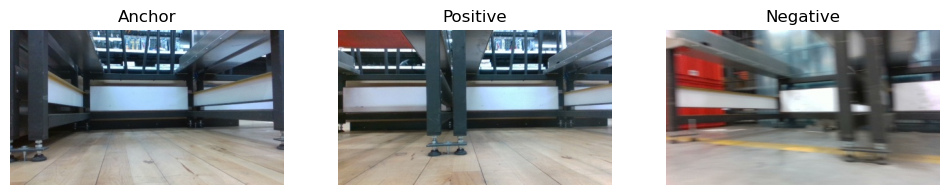

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730118_f.jpg`  
**Positive:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000391_f.jpg`  
**Negative:** `task_d7385cf7-7b0a-454a-8dab-878b8d07ffcf/1748441449_f.jpg`

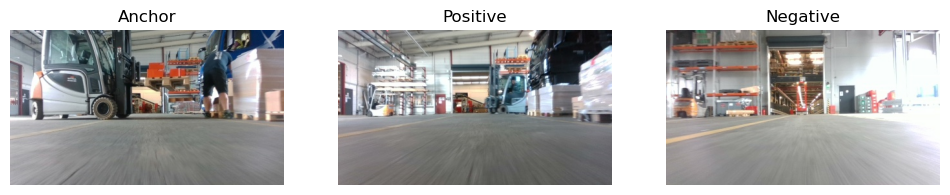

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730040_f.jpg`  
**Positive:** `task_3d5e0085-2129-45b1-a3ff-33fde3c58a59/1747638697_f.jpg`  
**Negative:** `task_6a515e27-14b7-4665-a45f-bd8a699c9ef3/1748354998_f.jpg`

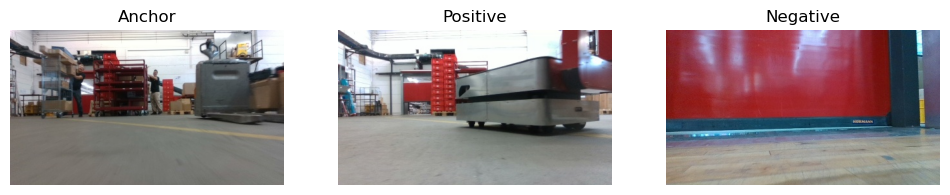

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730079_f.jpg`  
**Positive:** `task_ca76a9b5-d546-4a83-af2e-c7bb8a5f4429/1748005967_f.jpg`  
**Negative:** `task_3452e422-dec8-4d45-a653-690ce1e5d6a7/1747663880_f.jpg`

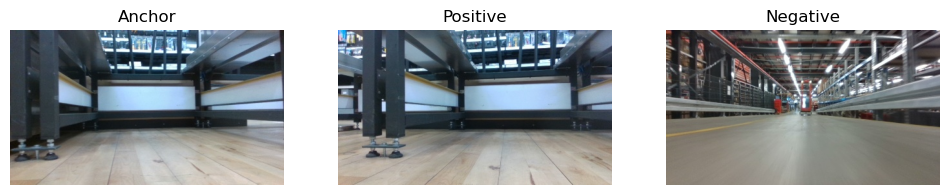

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730125_f.jpg`  
**Positive:** `task_9d6e8000-843a-4a20-8918-3ea9e1a2626f/1747645592_f.jpg`  
**Negative:** `task_3b312185-db01-4160-b484-7322c76df38a/1748252432_f.jpg`

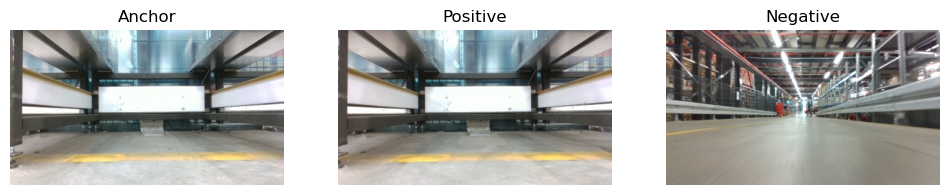

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730007_f.jpg`  
**Positive:** `task_e461bff2-b70e-4da1-bd23-f2726136f435/1748420873_f.jpg`  
**Negative:** `task_8fd993e8-8120-432c-877b-f0b058bf8715/1748269092_f.jpg`

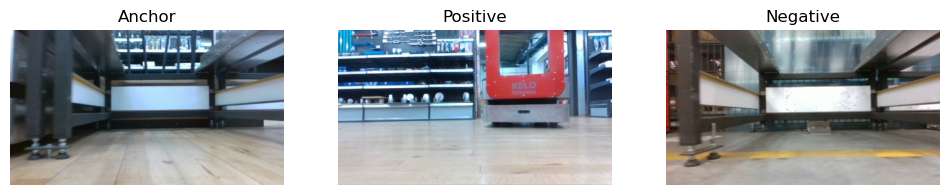

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730127_f.jpg`  
**Positive:** `task_919cdf43-98f1-4262-9f0a-1d8b7e2ad816/1747643193_f.jpg`  
**Negative:** `task_cee12fe3-773c-49d9-9b53-99b16c6dc90f/1748265561_f.jpg`

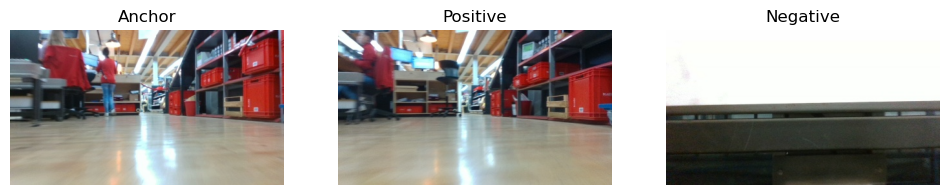

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730106_f.jpg`  
**Positive:** `task_b705bb45-d18f-4a55-b91b-22e6a7ab271f/1747985655_f.jpg`  
**Negative:** `task_1225f1a5-39d3-43d8-9493-fff20c3e84ed/1747657739_f.jpg`

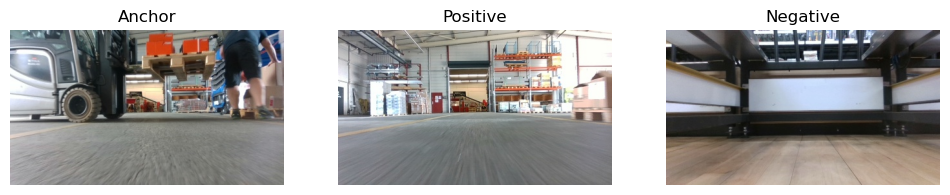

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730042_f.jpg`  
**Positive:** `task_c9af2340-fb7c-430d-9f5c-a496f69e7cd7/1748345721_f.jpg`  
**Negative:** `task_c434042c-e37f-42d8-851b-106f9bc4683e/1748246036_f.jpg`

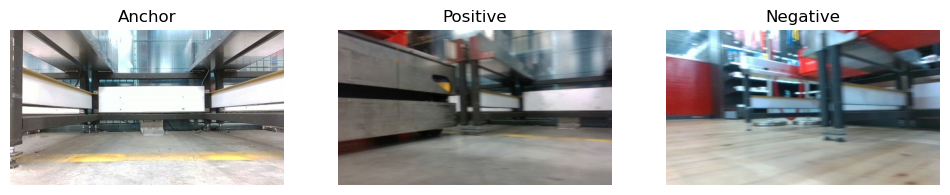

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730005_f.jpg`  
**Positive:** `task_cbcf7893-3ef4-411c-9159-79b63669d502/1748422030_f.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910113_f.jpg`

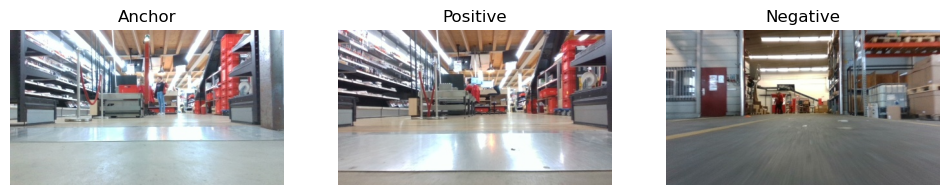

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730100_f.jpg`  
**Positive:** `task_64041a63-da77-428a-ab93-b23f567daa67/1748239704_f.jpg`  
**Negative:** `task_6dc45feb-093f-47a9-a1e2-157dd6768c4d/1747979959_f.jpg`

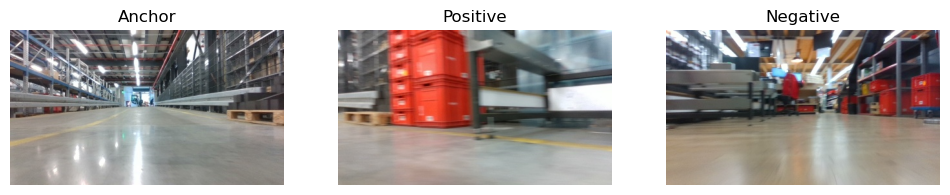

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730019_f.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909963_f.jpg`  
**Negative:** `task_363011dc-5861-415a-b8f0-b1b397a1cc23/1748416371_f.jpg`

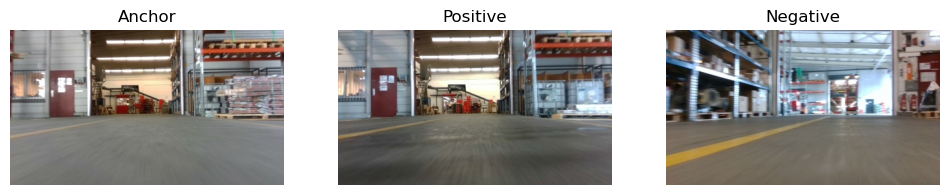

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730068_f.jpg`  
**Positive:** `task_97f7caa8-e8d1-45b7-b9ad-ab214ace84e3/1747814551_f.jpg`  
**Negative:** `task_6a515e27-14b7-4665-a45f-bd8a699c9ef3/1748354989_f.jpg`

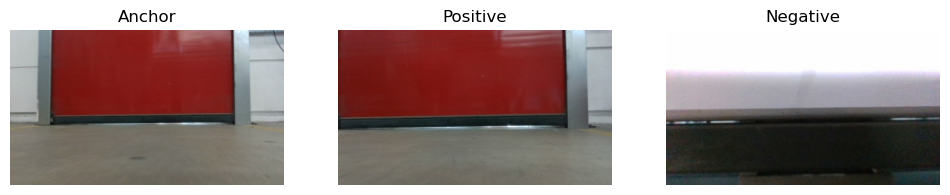

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730093_f.jpg`  
**Positive:** `task_1046584b-46c2-49e7-8768-76c97d1ea66b/1747315017_f.jpg`  
**Negative:** `task_3769d6fb-c138-488b-b636-d118395ebab7/1748262672_f.jpg`

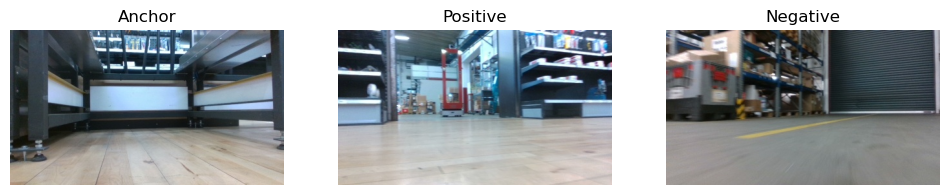

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730119_f.jpg`  
**Positive:** `task_3b312185-db01-4160-b484-7322c76df38a/1748252392_f.jpg`  
**Negative:** `task_8fd993e8-8120-432c-877b-f0b058bf8715/1748269065_f.jpg`

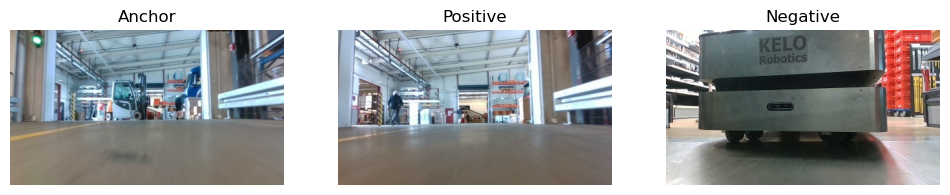

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730035_f.jpg`  
**Positive:** `task_40840fba-2897-41b2-9ef4-7e60d418843a/1748339952_f.jpg`  
**Negative:** `task_9a0edb98-0b11-414e-973f-8b5ac2747f56/1747406021_f.jpg`

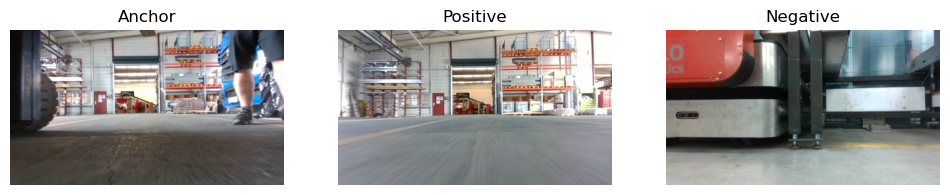

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730050_f.jpg`  
**Positive:** `task_140888d9-739b-4f18-9f7a-2e1d96e71446/1747653419_f.jpg`  
**Negative:** `task_556c4221-b515-4e37-9fae-3ea85a10e918/1748418138_f.jpg`

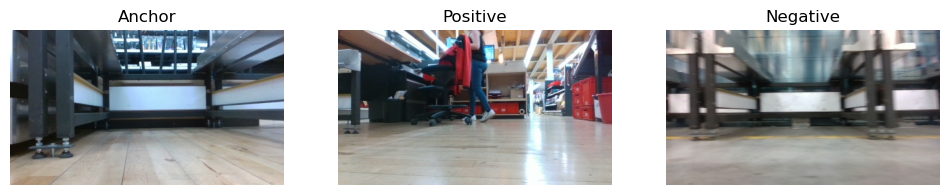

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730126_f.jpg`  
**Positive:** `task_4b4f17a3-aa00-4495-b4ea-b754bd074810/1747318403_f.jpg`  
**Negative:** `task_906d5303-7050-46cc-9341-3a7ad3e8369e/1748419545_f.jpg`

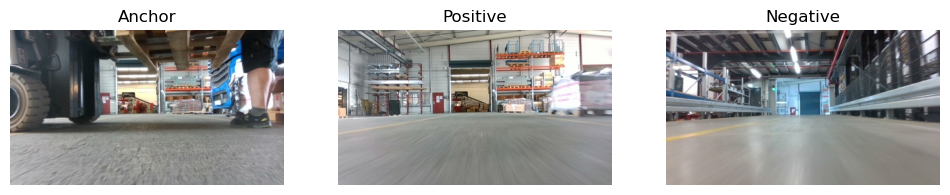

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730045_f.jpg`  
**Positive:** `task_6cbb51cf-7033-40bf-af18-6d0489f983e8/1747740443_f.jpg`  
**Negative:** `task_155e82ec-79bd-49b1-9253-e44eb119ba14/1748354840_f.jpg`

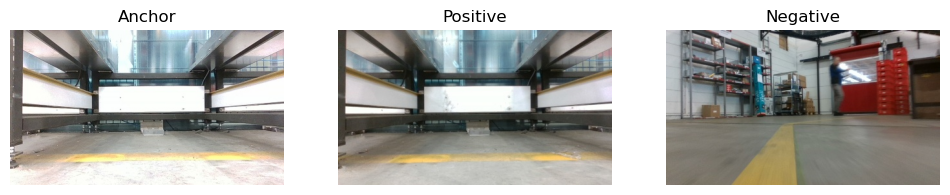

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730004_f.jpg`  
**Positive:** `task_6cbb51cf-7033-40bf-af18-6d0489f983e8/1747740410_f.jpg`  
**Negative:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330943_f.jpg`

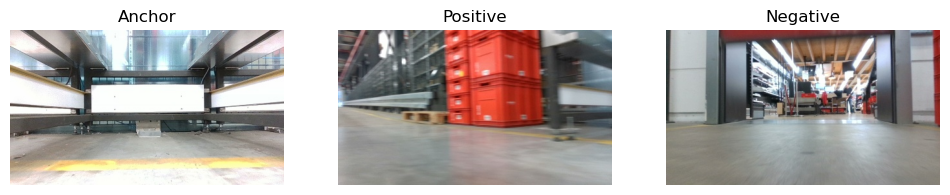

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730003_f.jpg`  
**Positive:** `task_d3541e98-cdc4-4625-bf36-524f722c8db7/1747903965_f.jpg`  
**Negative:** `task_27edfed1-08f7-47fa-9006-70e5acc8556d/1747986587_f.jpg`

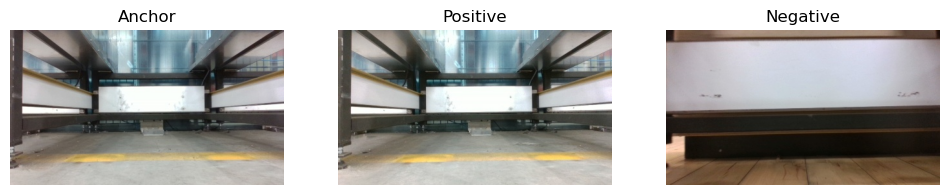

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730011_f.jpg`  
**Positive:** `task_d80015cc-e7e0-486d-9e14-2beff7c859ef/1747897531_f.jpg`  
**Negative:** `task_a7691202-35d4-4b18-8606-335f68c41dcc/1747986110_f.jpg`

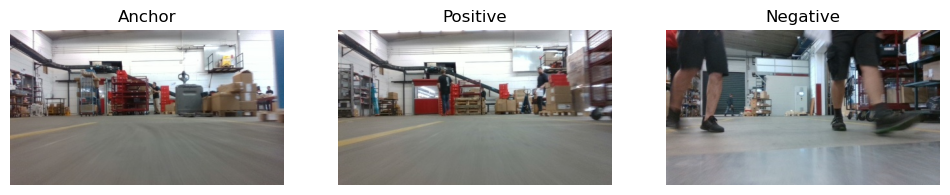

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730077_f.jpg`  
**Positive:** `task_155e82ec-79bd-49b1-9253-e44eb119ba14/1748354873_f.jpg`  
**Negative:** `task_c38a882a-4075-48f1-bf04-9c0df6f2fa11/1748421032_f.jpg`

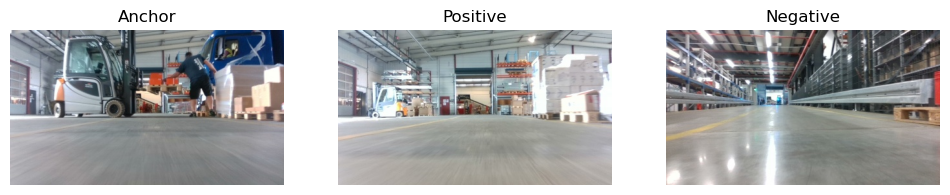

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730039_f.jpg`  
**Positive:** `task_88691d54-7c52-43f2-9017-9b00277f41c1/1747985111_f.jpg`  
**Negative:** `task_6dc45feb-093f-47a9-a1e2-157dd6768c4d/1747979931_f.jpg`

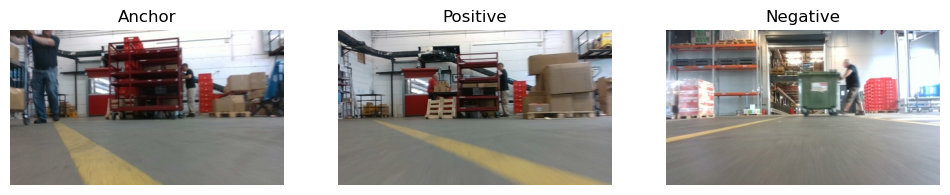

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730081_f.jpg`  
**Positive:** `task_d38fe44a-b113-4a74-b666-984b025ff712/1747741762_f.jpg`  
**Negative:** `task_f67166a4-25e7-496e-9f72-5ad64fe9c97a/1748242275_f.jpg`

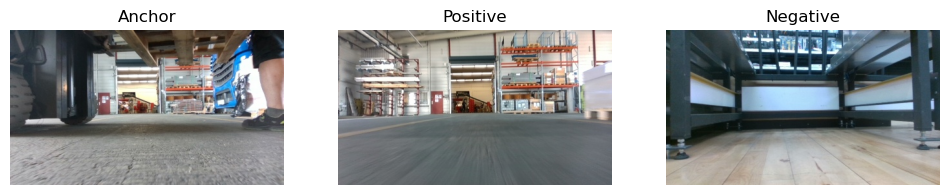

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730046_f.jpg`  
**Positive:** `task_fd65cc7f-abf3-4677-9072-d30fdb3bd832/1747642164_f.jpg`  
**Negative:** `task_d64ed855-eec6-48f6-9052-7740864ab548/1747718484_f.jpg`

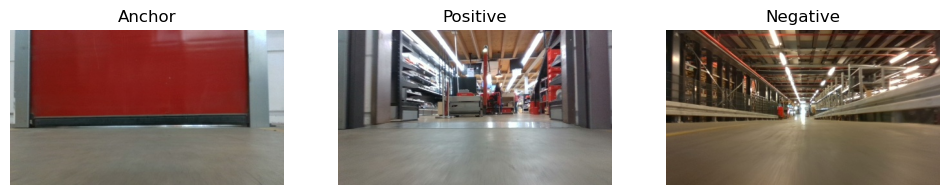

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730094_f.jpg`  
**Positive:** `task_4b4f17a3-aa00-4495-b4ea-b754bd074810/1747318389_f.jpg`  
**Negative:** `task_785a16bb-b79f-4d6a-b35e-675204f9a739/1747645934_f.jpg`

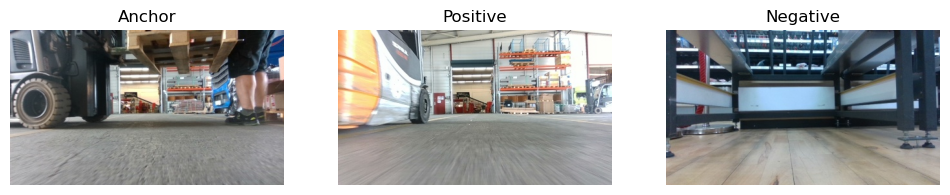

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730044_f.jpg`  
**Positive:** `task_3ff5fb5d-a693-402b-8e1d-ac5108bd5804/1747993632_f.jpg`  
**Negative:** `task_5494a279-8247-448c-b8c2-5f8ac595fd07/1748011548_f.jpg`

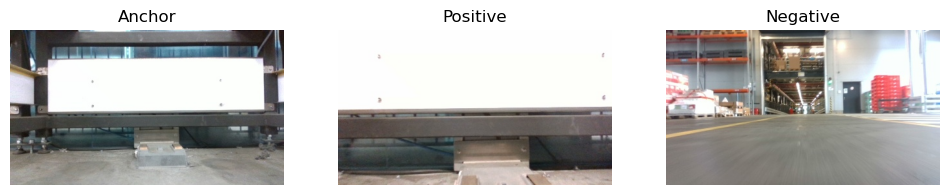

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729999_f.jpg`  
**Positive:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919493_f.jpg`  
**Negative:** `task_0b2e8033-8eca-4dfc-8694-e5e2ec75b9c7/1748251196_f.jpg`

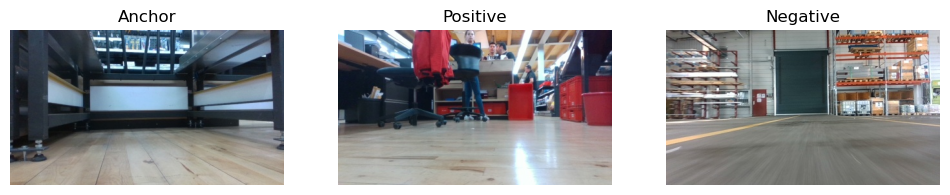

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730116_f.jpg`  
**Positive:** `task_70e2f625-aaa9-4bc8-ba95-932cc3018957/1747403321_f.jpg`  
**Negative:** `task_84614c06-0a06-4a5f-be25-fbe5d0bbf68e/1748265693_f.jpg`

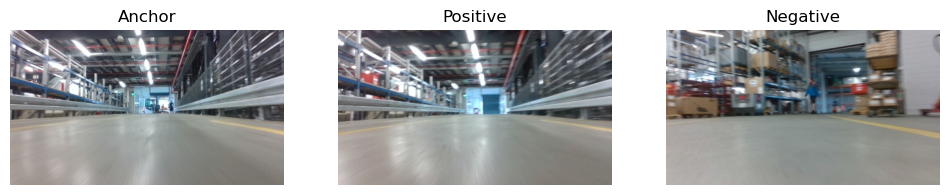

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730025_f.jpg`  
**Positive:** `task_5494a279-8247-448c-b8c2-5f8ac595fd07/1748011478_f.jpg`  
**Negative:** `task_fbf18695-33af-42eb-8de3-9a955f3d2ee3/1748237424_f.jpg`

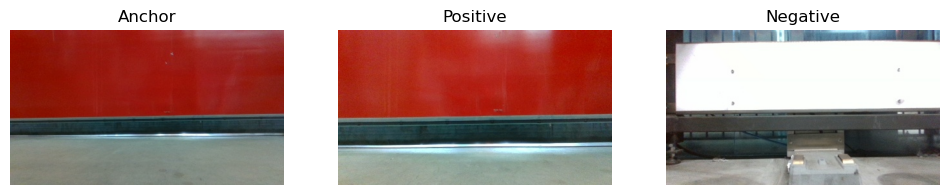

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730098_f.jpg`  
**Positive:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330962_f.jpg`  
**Negative:** `task_3037d52e-157f-45ab-98f8-b681ae1d7ad0/1748439777_f.jpg`

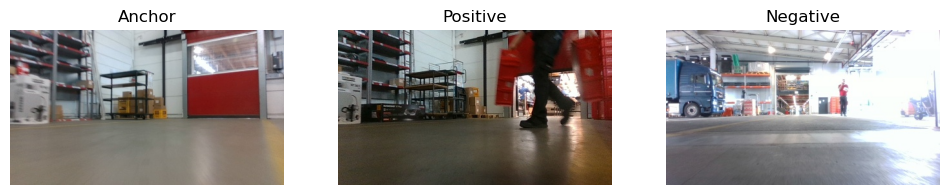

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730088_f.jpg`  
**Positive:** `task_9a0edb98-0b11-414e-973f-8b5ac2747f56/1747406004_f.jpg`  
**Negative:** `task_c434042c-e37f-42d8-851b-106f9bc4683e/1748246106_f.jpg`

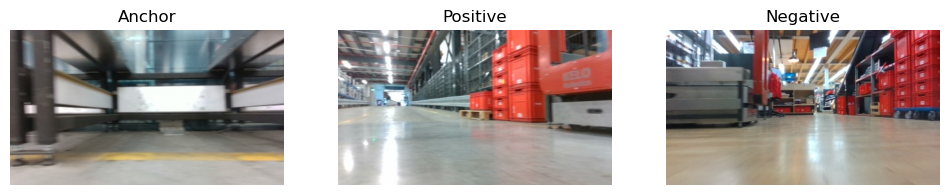

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730014_f.jpg`  
**Positive:** `task_8aa2af4a-bae3-432f-96fd-c3654229b402/1748332864_f.jpg`  
**Negative:** `task_e4cef4d1-0e3a-4fdc-b13a-b48cf1809bc1/1747722029_f.jpg`

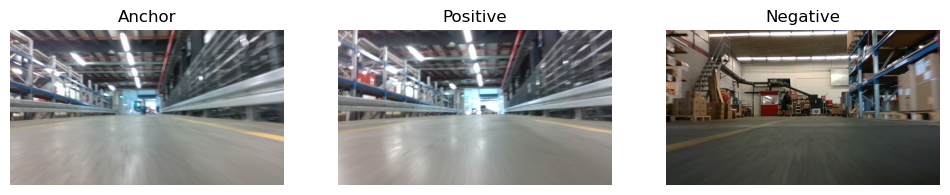

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730024_f.jpg`  
**Positive:** `task_c479dca1-a0c2-4522-977d-78fe2f58a0a1/1747987614_f.jpg`  
**Negative:** `task_a7691202-35d4-4b18-8606-335f68c41dcc/1747986059_f.jpg`

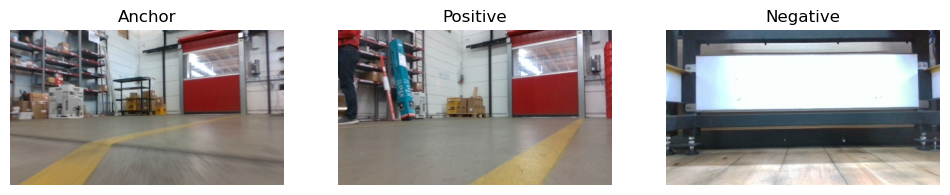

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730087_f.jpg`  
**Positive:** `task_379cef85-d855-4a07-b9d5-c83efd9bffb9/1747978813_f.jpg`  
**Negative:** `task_bfb67e98-36d4-4ef4-8902-f440c910bb27/1747980086_f.jpg`

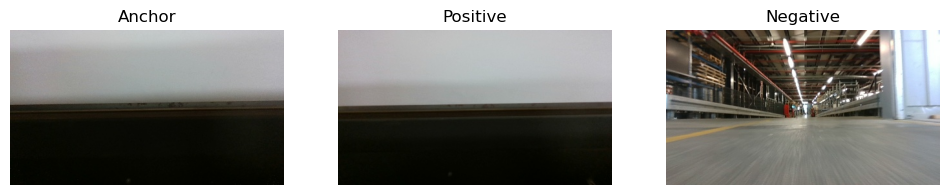

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730136_f.jpg`  
**Positive:** `task_e521cd22-859c-4d54-b367-0c136a179a0b/1747992342_f.jpg`  
**Negative:** `task_60a788d7-1764-49e6-98dd-2e4accde86b0/1747913849_f.jpg`

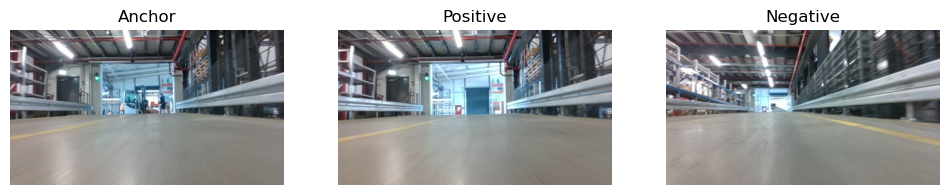

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730031_f.jpg`  
**Positive:** `task_9c58ecc8-4c4b-4b8d-ab8a-239240e87b26/1748004204_f.jpg`  
**Negative:** `task_168b310d-82a3-4a49-8d6d-73da8981aa9e/1747741985_f.jpg`

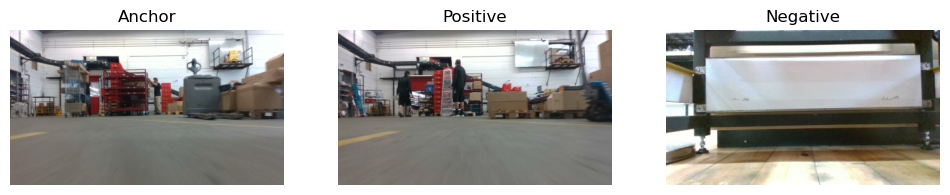

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730078_f.jpg`  
**Positive:** `task_45caba50-386d-4fe3-b39b-db10f105fb0e/1747984828_f.jpg`  
**Negative:** `task_48c25151-12e8-49aa-906d-417d53fdb4ce/1747656041_f.jpg`

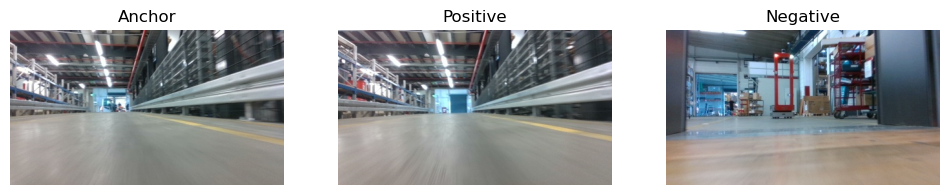

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730023_f.jpg`  
**Positive:** `task_b1e81605-ed5d-434e-ab67-31f6a9c41393/1747999844_f.jpg`  
**Negative:** `task_bdae859f-eb26-4780-8713-982f8e48a41c/1748436814_f.jpg`

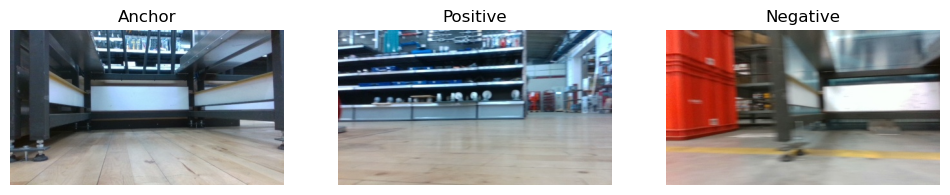

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730124_f.jpg`  
**Positive:** `task_9d6e8000-843a-4a20-8918-3ea9e1a2626f/1747645544_f.jpg`  
**Negative:** `task_7f37c03d-d371-4dd7-9b84-b9061e1bcac1/1748263995_f.jpg`

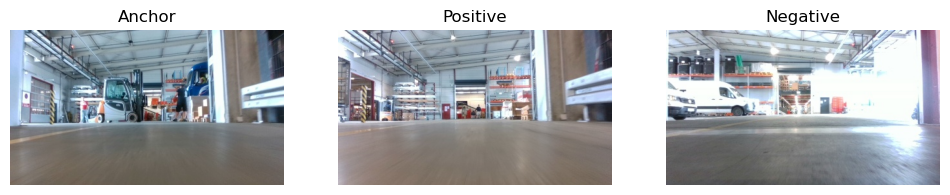

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730036_f.jpg`  
**Positive:** `task_e2d790f0-470d-416b-8f4a-8f6a1a5bb409/1748251318_f.jpg`  
**Negative:** `task_cf50b5bd-9204-4125-9ed0-183e09fc260a/1748250406_f.jpg`

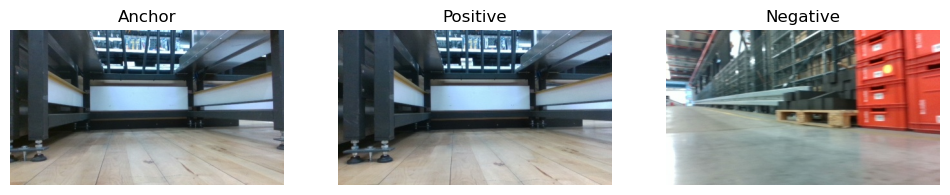

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730120_f.jpg`  
**Positive:** `task_0d48733d-77c3-43c3-b87e-57ed9245d8ca/1748426877_f.jpg`  
**Negative:** `task_1046584b-46c2-49e7-8768-76c97d1ea66b/1747314963_f.jpg`

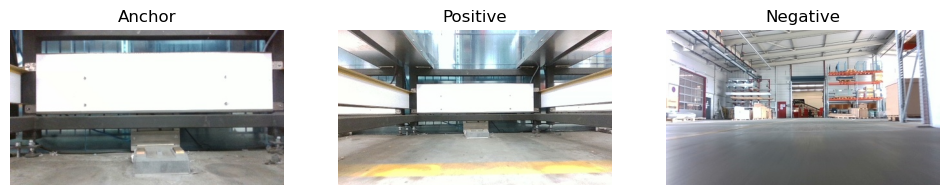

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729998_f.jpg`  
**Positive:** `task_fd65cc7f-abf3-4677-9072-d30fdb3bd832/1747642125_f.jpg`  
**Negative:** `task_0546ed48-56b1-421d-a839-ca45c6f9ef4a/1747993190_f.jpg`

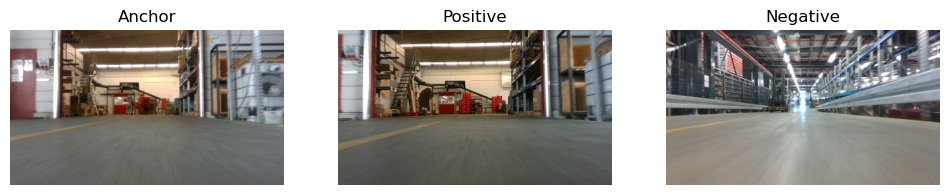

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730070_f.jpg`  
**Positive:** `task_ba87297f-b6d2-427d-9589-a67f02cf8e49/1747314606_f.jpg`  
**Negative:** `task_de4e5e30-8461-4a0e-b398-56a946d66044/1747653888_f.jpg`

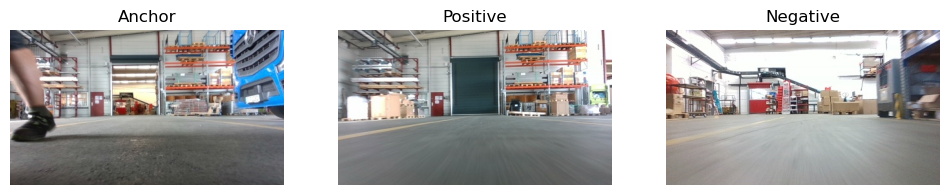

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730055_f.jpg`  
**Positive:** `task_5b0ff856-87f6-484b-9b94-019cdb570c90/1747997137_f.jpg`  
**Negative:** `task_72607ac4-b749-45da-8b53-ac5d59583058/1747976441_f.jpg`

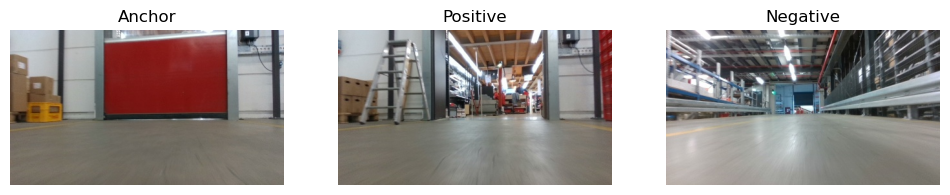

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730091_f.jpg`  
**Positive:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831428_f.jpg`  
**Negative:** `task_52612c7c-7aa5-4096-a0de-0dd603c4c93e/1748268921_f.jpg`

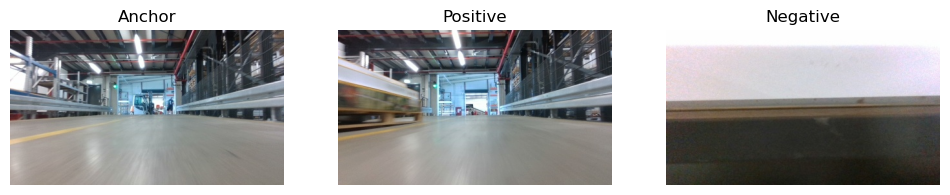

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730029_f.jpg`  
**Positive:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831370_f.jpg`  
**Negative:** `task_0b2e8033-8eca-4dfc-8694-e5e2ec75b9c7/1748251145_f.jpg`

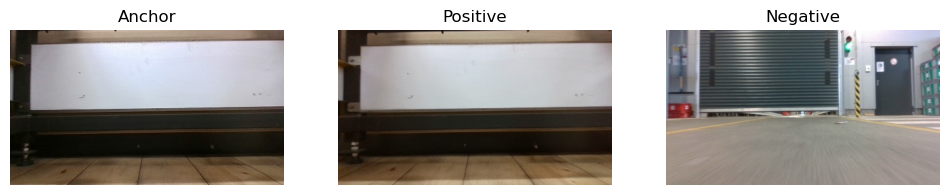

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730134_f.jpg`  
**Positive:** `task_45caba50-386d-4fe3-b39b-db10f105fb0e/1747984883_f.jpg`  
**Negative:** `task_0ec6ccd2-dbea-4725-a3c0-0a904a3cf800/1747978950_f.jpg`

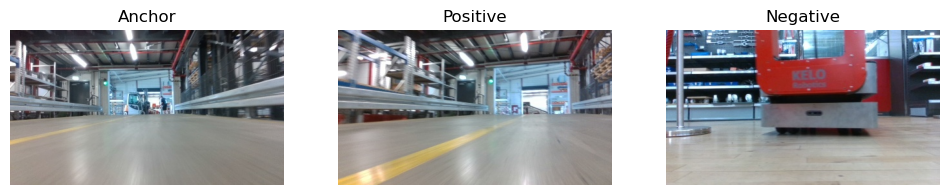

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730030_f.jpg`  
**Positive:** `task_7498a815-38db-44f2-99f4-85958d03d3d4/1748417171_f.jpg`  
**Negative:** `task_a7571975-77c8-4756-967e-979b2344ecc6/1748419095_f.jpg`

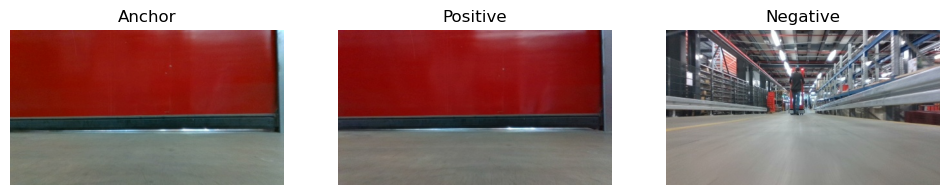

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730096_f.jpg`  
**Positive:** `task_9e56d516-da75-4a58-b4d1-1d612ce82408/1747987943_f.jpg`  
**Negative:** `task_0a66905f-f5c1-4705-820c-daaacd0e511e/1748006134_f.jpg`

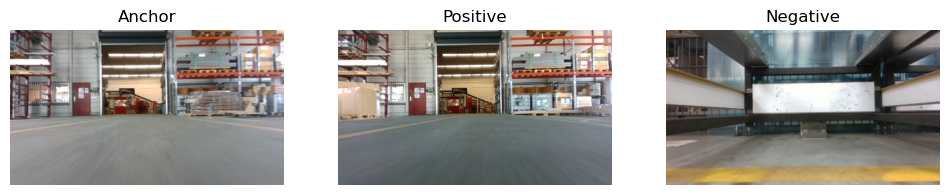

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730066_f.jpg`  
**Positive:** `task_02823ae4-0cae-4911-bce9-416b8ef7c0a3/1747647576_f.jpg`  
**Negative:** `task_9de408b2-64ad-4dd5-b8ef-a2290086ed1d/1747314818_f.jpg`

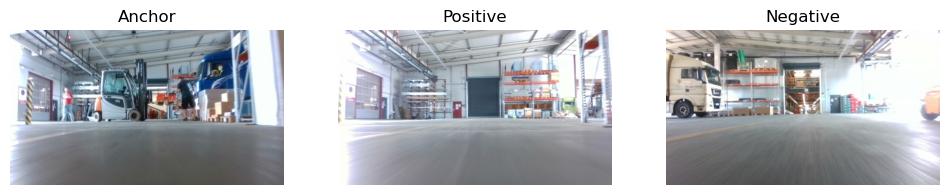

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730037_f.jpg`  
**Positive:** `task_ca76a9b5-d546-4a83-af2e-c7bb8a5f4429/1748005869_f.jpg`  
**Negative:** `task_b259588a-6253-410f-a1a6-ed72bf8e2804/1747643774_f.jpg`

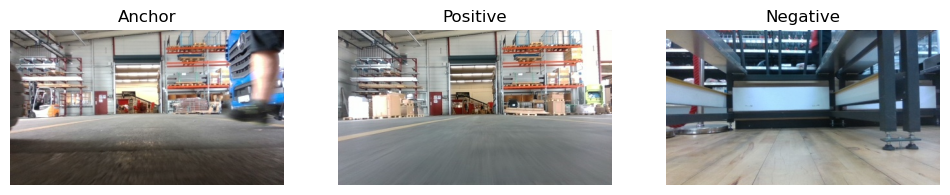

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730051_f.jpg`  
**Positive:** `task_06adb7ae-c3bf-4a9f-af05-68bad8bc3590/1747995046_f.jpg`  
**Negative:** `task_ca76a9b5-d546-4a83-af2e-c7bb8a5f4429/1748005998_f.jpg`

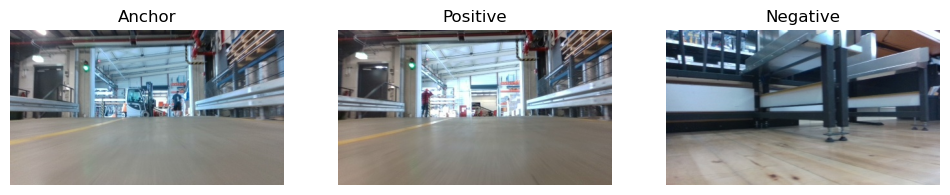

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730033_f.jpg`  
**Positive:** `task_c479dca1-a0c2-4522-977d-78fe2f58a0a1/1747987624_f.jpg`  
**Negative:** `task_4b4f17a3-aa00-4495-b4ea-b754bd074810/1747318421_f.jpg`

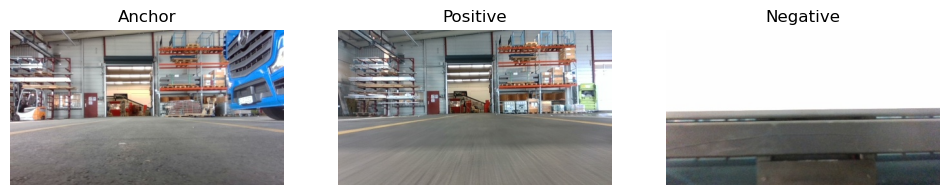

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730059_f.jpg`  
**Positive:** `task_34c6a53c-ab23-4aae-9fc9-00c3d0c8db2f/1748261417_f.jpg`  
**Negative:** `task_076069b0-e4b2-4e08-8409-96409d95fe53/1747650543_f.jpg`

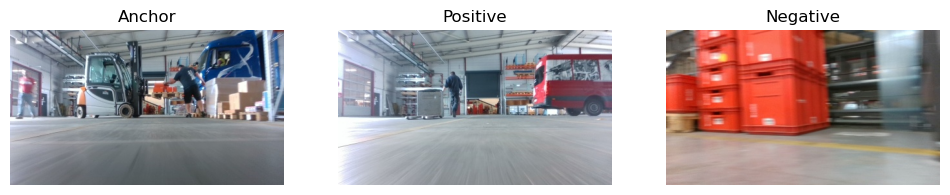

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730038_f.jpg`  
**Positive:** `task_de06c9ce-ceb0-48ab-83f4-1625528c1560/1748006413_f.jpg`  
**Negative:** `task_c479dca1-a0c2-4522-977d-78fe2f58a0a1/1747987604_f.jpg`

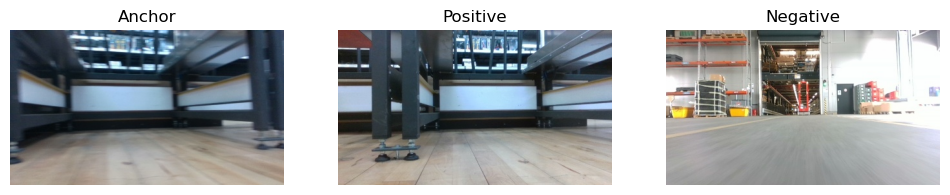

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730115_f.jpg`  
**Positive:** `task_9e56d516-da75-4a58-b4d1-1d612ce82408/1747987984_f.jpg`  
**Negative:** `task_0e23e758-66f7-4518-9c69-8feb613b4554/1747662066_f.jpg`

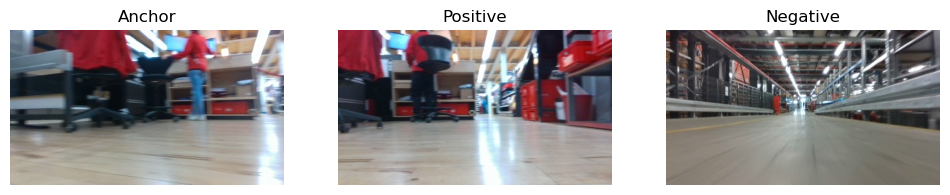

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730112_f.jpg`  
**Positive:** `task_0dfe2139-b15e-4233-9797-ed84aa839a98/1747984022_f.jpg`  
**Negative:** `task_4f91834d-7e00-45b3-9910-706c2d4dfb1d/1747982509_f.jpg`

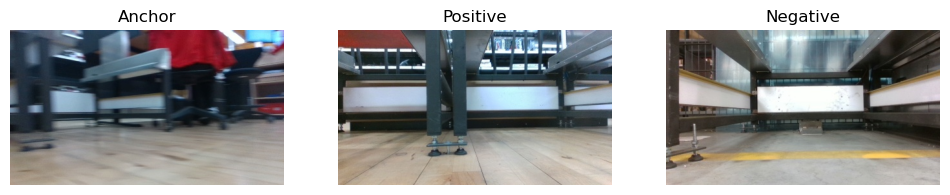

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730113_f.jpg`  
**Positive:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000341_f.jpg`  
**Negative:** `task_64041a63-da77-428a-ab93-b23f567daa67/1748239630_f.jpg`

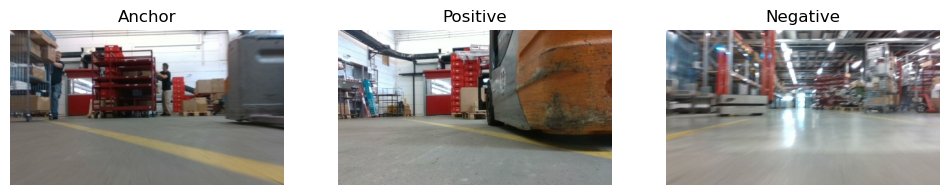

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730080_f.jpg`  
**Positive:** `task_4f42c4e4-638a-45d4-88d1-d6fc7a17d9ae/1747998266_f.jpg`  
**Negative:** `task_556c4221-b515-4e37-9fae-3ea85a10e918/1748418115_f.jpg`

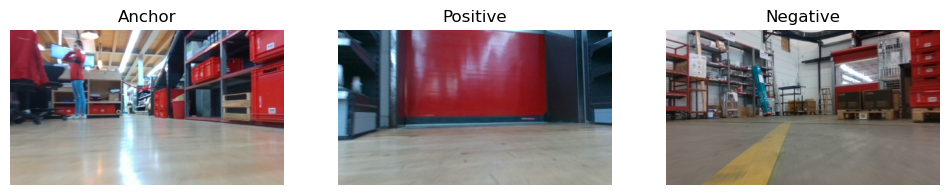

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730107_f.jpg`  
**Positive:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910120_f.jpg`  
**Negative:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831402_f.jpg`

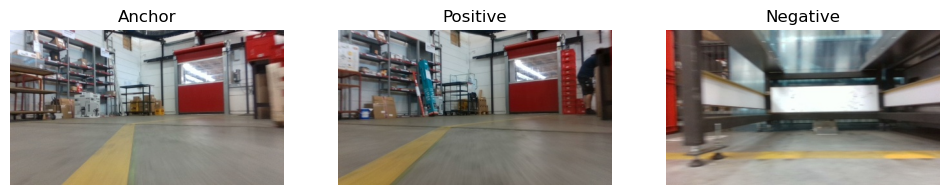

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730086_f.jpg`  
**Positive:** `task_3ff5fb5d-a693-402b-8e1d-ac5108bd5804/1747993654_f.jpg`  
**Negative:** `task_27edfed1-08f7-47fa-9006-70e5acc8556d/1747986530_f.jpg`

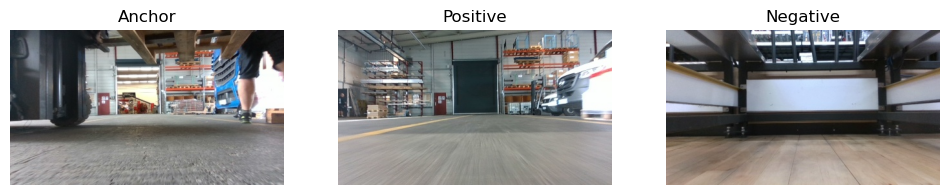

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730047_f.jpg`  
**Positive:** `task_827d51ea-f364-4c13-8a91-8333944609ca/1748250568_f.jpg`  
**Negative:** `task_52612c7c-7aa5-4096-a0de-0dd603c4c93e/1748268996_f.jpg`

In [15]:
### Visualize the ground truth ***********************************************************
triplets = []
with open(gt_path, 'r') as f:
    for i, line in enumerate(f):
        if i >= 100:
            break
        anchor, positive, negative = line.strip().split()
        triplets.append((anchor, positive, negative))

for idx, (anchor, positive, negative) in enumerate(triplets):
    fig, axes = plt.subplots(1, 3, figsize=(12, 3))
    for j, img_path in enumerate([anchor, positive, negative]):
        ax = axes[j]
        full_path = os.path.join(dataset_root, img_path)
        img = mpimg.imread(full_path)
        ax.imshow(img)
        ax.axis('off')
        if j == 0:
            ax.set_title("Anchor")
        elif j == 1:
            ax.set_title("Positive")
        else:
            ax.set_title("Negative")
    plt.show()

    display(Markdown(
        f"**Anchor:** `{anchor}`  \n"
        f"**Positive:** `{positive}`  \n"
        f"**Negative:** `{negative}`"
    ))